In [0]:
import pandas as pd
import matplotlib.pyplot as plt
from pyspark.sql.functions import col, explode, struct, split, array, when, count, desc, asc, rank, round, regexp_replace, year, to_date, expr, size
from pyspark.sql.window import Window
from pyspark.sql import SparkSession
from pyspark.sql.functions import sum as spark_sum


In [0]:
df = spark.read.json("s3://full-stack-bigdata-datasets/Big_Data/Project_Steam/steam_game_output.json")

### Schéma du dataframe

In [0]:
df.printSchema()

root
 |-- data: struct (nullable = true)
 |    |-- appid: long (nullable = true)
 |    |-- categories: array (nullable = true)
 |    |    |-- element: string (containsNull = true)
 |    |-- ccu: long (nullable = true)
 |    |-- developer: string (nullable = true)
 |    |-- discount: string (nullable = true)
 |    |-- genre: string (nullable = true)
 |    |-- header_image: string (nullable = true)
 |    |-- initialprice: string (nullable = true)
 |    |-- languages: string (nullable = true)
 |    |-- name: string (nullable = true)
 |    |-- negative: long (nullable = true)
 |    |-- owners: string (nullable = true)
 |    |-- platforms: struct (nullable = true)
 |    |    |-- linux: boolean (nullable = true)
 |    |    |-- mac: boolean (nullable = true)
 |    |    |-- windows: boolean (nullable = true)
 |    |-- positive: long (nullable = true)
 |    |-- price: string (nullable = true)
 |    |-- publisher: string (nullable = true)
 |    |-- release_date: string (nullable = true)
 |    |-

###Crétation d'un dataframe exploitable qui 'déploie' les éléments structurés

In [0]:
data_fields = [f"data.{field.name}" for field in df.schema["data"].dataType.fields]
data = df.select("id", *data_fields)


In [0]:
display(data)

id,appid,categories,ccu,developer,discount,genre,header_image,initialprice,languages,name,negative,owners,platforms,positive,price,publisher,release_date,required_age,short_description,tags,type,website
10,10,"List(Multi-player, Valve Anti-Cheat enabled, Online PvP, Shared/Split Screen PvP, PvP)",13990,Valve,0,Action,https://cdn.akamai.steamstatic.com/steam/apps/10/header.jpg?t=1666823513,999,"English, French, German, Italian, Spanish - Spain, Simplified Chinese, Traditional Chinese, Korean",Counter-Strike,5199,"10,000,000 .. 20,000,000","List(true, true, true)",201215,999,Valve,2000/11/1,0,Play the world's number 1 online action game. Engage in an incredibly realistic brand of terrorist warfare in this wildly popular team-based game. Ally with teammates to complete strategic missions. Take out enemy sites. Rescue hostages. Your role affects your team's success. Your team's success affects your role.,"List(266, 1191, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 5426, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 227, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 2784, null, null, null, null, null, null, null, null, null, null, null, null, 1607, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 4831, null, null, null, null, null, null, null, null, null, 1707, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 632, null, null, null, null, null, null, null, null, null, null, null, 3392, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 131, null, null, 769, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 881, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 289, null, null, null, 3353, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 614, null, null, null, null, null, null, 304, null, null, null, 1344, null, null, 1864, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 1192)",game,
1000000,1000000,"List(Single-player, Partial Controller Support, Steam Achievements, Steam Cloud)",0,IndigoBlue Game Studio,0,"Action, Adventure, Indie",https://cdn.akamai.steamstatic.com/steam/apps/1000000/header.jpg?t=1655723048,999,"English, Korean, Simplified Chinese",ASCENXION,5,"0 .. 20,000","List(false, false, true)",27,999,PsychoFlux Entertainment,2021/05/14,0,"ASCENXION is a 2D shoot 'em up game where you explore the field 

### Suppression du type 'hardware' : l'étude étant centré sur les jeux-vidéos

In [0]:
data.select("type").distinct().show()

+--------+
|    type|
+--------+
|hardware|
|    game|
+--------+



In [0]:
data = data.filter(data.type != 'hardware').drop('type')

In [0]:
data = data.drop('appid')
data = data.drop('header_image')
data = data.drop('website')

In [0]:
display(data)

id,categories,ccu,developer,discount,genre,initialprice,languages,name,negative,owners,platforms,positive,price,publisher,release_date,required_age,short_description,tags
10,"List(Multi-player, Valve Anti-Cheat enabled, Online PvP, Shared/Split Screen PvP, PvP)",13990,Valve,0,Action,999,"English, French, German, Italian, Spanish - Spain, Simplified Chinese, Traditional Chinese, Korean",Counter-Strike,5199,"10,000,000 .. 20,000,000","List(true, true, true)",201215,999,Valve,2000/11/1,0,Play the world's number 1 online action game. Engage in an incredibly realistic brand of terrorist warfare in this wildly popular team-based game. Ally with teammates to complete strategic missions. Take out enemy sites. Rescue hostages. Your role affects your team's success. Your team's success affects your role.,"List(266, 1191, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 5426, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 227, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 2784, null, null, null, null, null, null, null, null, null, null, null, null, 1607, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 4831, null, null, null, null, null, null, null, null, null, 1707, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 632, null, null, null, null, null, null, null, null, null, null, null, 3392, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 131, null, null, 769, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 881, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 289, null, null, null, 3353, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 614, null, null, null, null, null, null, 304, null, null, null, 1344, null, null, 1864, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 1192)"
1000000,"List(Single-player, Partial Controller Support, Steam Achievements, Steam Cloud)",0,IndigoBlue Game Studio,0,"Action, Adventure, Indie",999,"English, Korean, Simplified Chinese",ASCENXION,5,"0 .. 20,000","List(false, false, true)",27,999,PsychoFlux Entertainment,2021/05/14,0,"ASCENXION is a 2D shoot 'em up game where you explore the field to progress. Players must overcome puzzles, traps, elite units, boss fights, and other various obstacles while navigating the field. Grow stronger through rewards earned, to uncover the truth of this 

In [0]:
owners = data.select("owners").distinct()

In [0]:
owners = owners.withColumn('owner_first_part', split(col('owners'), ' ')[0])
display(owners.select('owner_first_part'))

owner_first_part
"100,000"
"1,000,000"
"20,000,000"
"5,000,000"
0
"20,000"
"2,000,000"
"50,000,000"
"200,000,000"
"500,000"


In [0]:
data = data.withColumn('owner_first_part', split(col('owners'), ' ')[0])

In [0]:
data = data.withColumn('owner_first_part', regexp_replace(col('owner_first_part'), ',', '').cast('int'))

In [0]:
value_counts = data.groupBy('owner_first_part').agg(count('*').alias('count')).orderBy(col('owner_first_part').desc())
display(value_counts)

owner_first_part,count
200000000,1
50000000,4
20000000,21
10000000,41
5000000,97
2000000,335
1000000,526
500000,932
200000,2162
100000,2519


### Création d'un dataframe 'most_owned' répertoriant les jeux possédés par au moins 1 000 000 de comptes (cela représente environ les 1000 jeux les plus possédés)

In [0]:
most_owned = data.filter(col('owner_first_part') > 1000000)
display(most_owned)

id,categories,ccu,developer,discount,genre,initialprice,languages,name,negative,owners,platforms,positive,price,publisher,release_date,required_age,short_description,tags,owner_first_part
10,"List(Multi-player, Valve Anti-Cheat enabled, Online PvP, Shared/Split Screen PvP, PvP)",13990,Valve,0,Action,999,"English, French, German, Italian, Spanish - Spain, Simplified Chinese, Traditional Chinese, Korean",Counter-Strike,5199,"10,000,000 .. 20,000,000","List(true, true, true)",201215,999,Valve,2000/11/1,0,Play the world's number 1 online action game. Engage in an incredibly realistic brand of terrorist warfare in this wildly popular team-based game. Ally with teammates to complete strategic missions. Take out enemy sites. Rescue hostages. Your role affects your team's success. Your team's success affects your role.,"List(266, 1191, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 5426, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 227, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 2784, null, null, null, null, null, null, null, null, null, null, null, null, 1607, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 4831, null, null, null, null, null, null, null, null, null, 1707, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 632, null, null, null, null, null, null, null, null, null, null, null, 3392, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 131, null, null, 769, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 881, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 289, null, null, null, 3353, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 614, null, null, null, null, null, null, 304, null, null, null, 1344, null, null, 1864, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, null, 1192)",10000000
10090,"List(Multi-player, Single-player, Co-op)",522,Treyarch,0,Action,1999,"English, French, Italian, German, Spanish - Spain",Call of Duty: World at War,3493,"2,000,000 .. 5,000,000","List(false, false, true)",39281,1999,Activision,2008/11/18,0,"Call of Duty is back, redefining war like you've never experienced before. Building on the Call of Duty 4®: Modern Warfare engine, Call of Duty: World at War immerses players into the most gritty and chaotic WWII combat ever experienced.","List(null, null, null, null, null, n

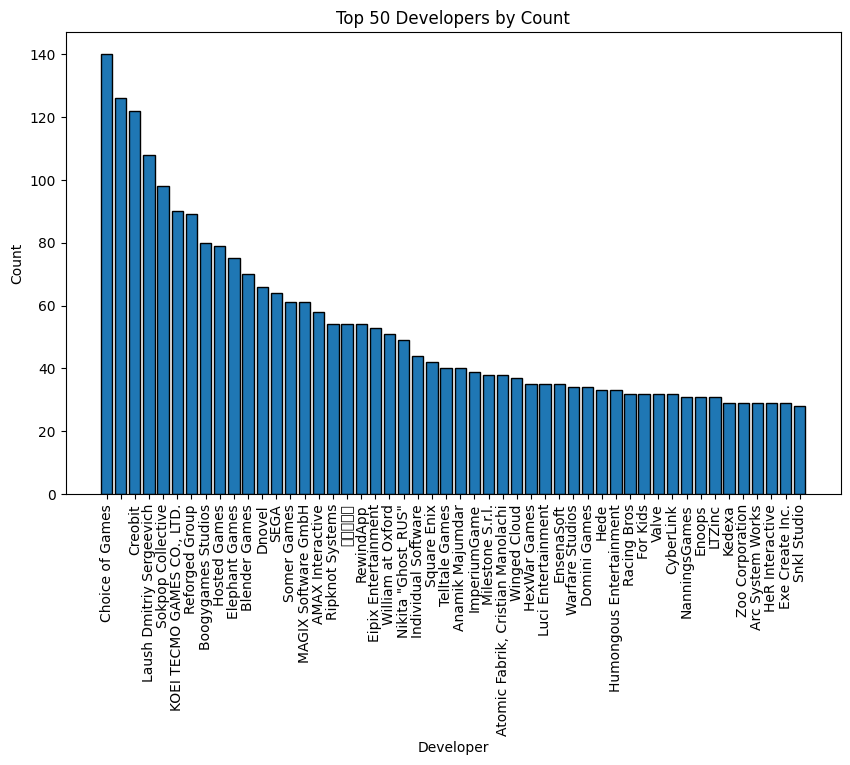

In [0]:
import matplotlib.pyplot as plt

developer_counts = data.groupBy('developer').count().orderBy('count', ascending=False).limit(50).toPandas()

plt.figure(figsize=(10, 6))
plt.bar(developer_counts['developer'], developer_counts['count'], edgecolor='black')
plt.xlabel('Developer')
plt.ylabel('Count')
plt.title('Top 50 Developers by Count')
plt.xticks(rotation=90)
plt.show()

### Les développeurs les plus productifs sont des développeurs de jeux mobiles 

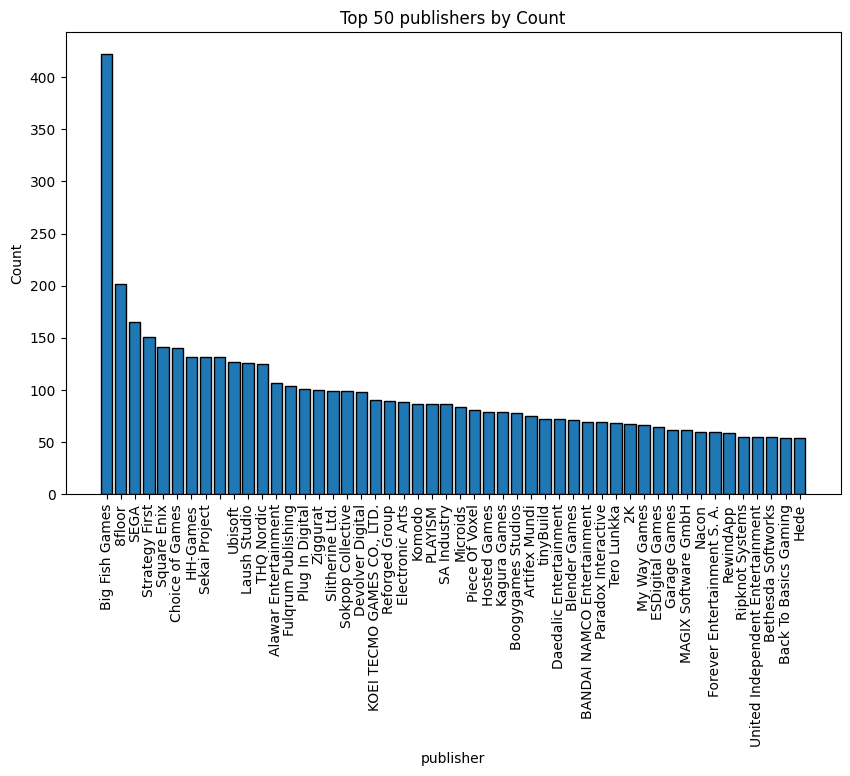

In [0]:
publisher_counts = data.groupBy('publisher').count().orderBy('count', ascending=False).limit(50).toPandas()

plt.figure(figsize=(10, 6))
plt.bar(publisher_counts['publisher'], publisher_counts['count'], edgecolor='black')
plt.xlabel('publisher')
plt.ylabel('Count')
plt.title('Top 50 publishers by Count')
plt.xticks(rotation=90)
plt.show()

### Chez les éditeurs on retrouve des noms un peu plus connus mais le plus important éditeur reste un éditeur de jeux mobiles

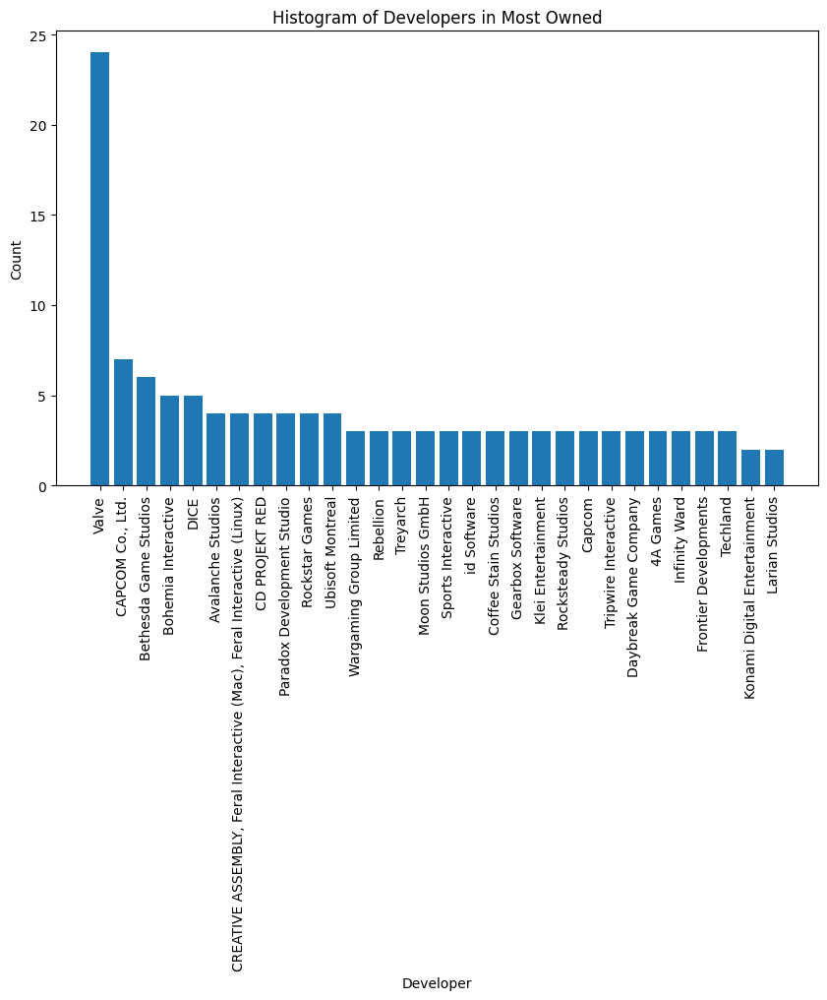

In [0]:
developer_counts = most_owned.groupBy('developer').count().orderBy('count', ascending=False).limit(30).toPandas()

plt.figure(figsize=(10, 6))
plt.bar(developer_counts['developer'], developer_counts['count'])
plt.xlabel('Developer')
plt.ylabel('Count')
plt.title('Histogram of Developers in Most Owned')
plt.xticks(rotation=90)
plt.show()

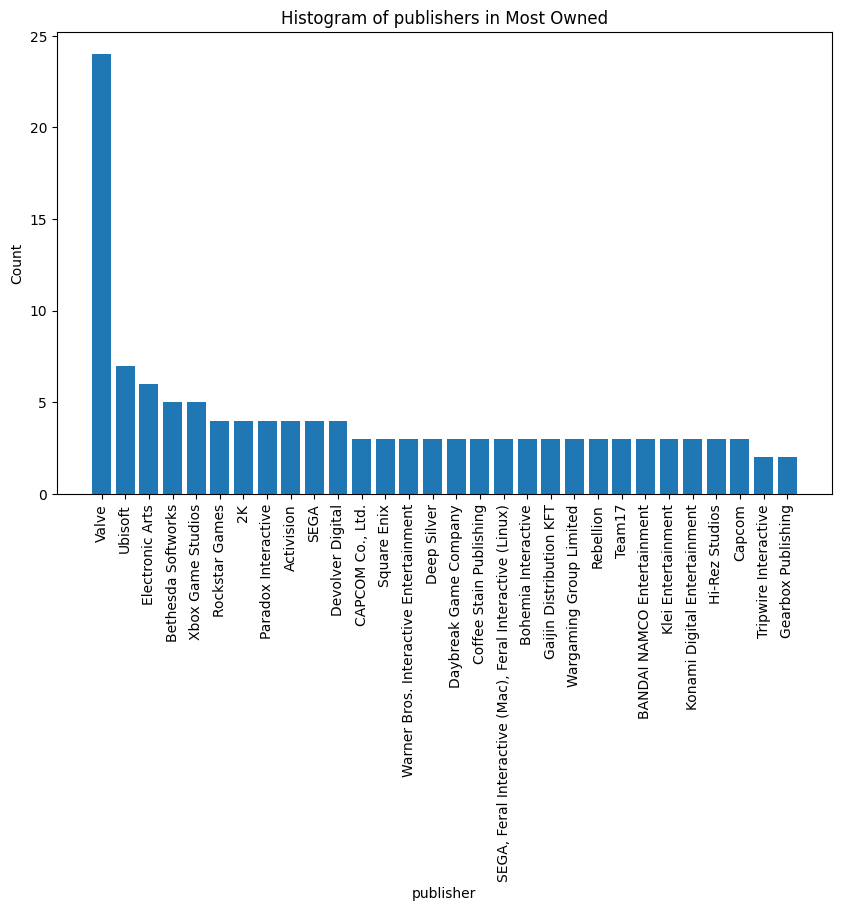

In [0]:
publisher_counts = most_owned.groupBy('publisher').count().orderBy('count', ascending=False).limit(30).toPandas()

plt.figure(figsize=(10, 6))
plt.bar(publisher_counts['publisher'], developer_counts['count'])
plt.xlabel('publisher')
plt.ylabel('Count')
plt.title('Histogram of publishers in Most Owned')
plt.xticks(rotation=90)
plt.show()

### Chez les jeux plus possédés on retrouve de grands noms de développeur et d'éditeur et ceux de mobiles ont disparu

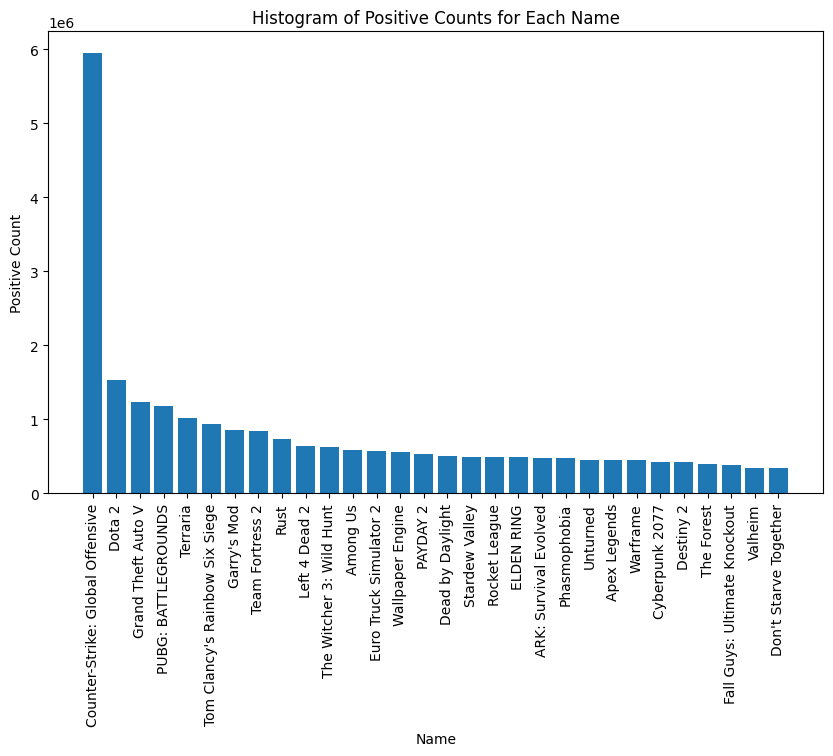

In [0]:
positive_counts = most_owned.groupBy('name').agg({'positive': 'sum'}).orderBy('sum(positive)', ascending=False).limit(30).toPandas()

plt.figure(figsize=(10, 6))
plt.bar(positive_counts['name'], positive_counts['sum(positive)'])
plt.xlabel('Name')
plt.ylabel('Positive Count')
plt.title('Histogram of Positive Counts for Each Name')
plt.xticks(rotation=90)
plt.show()

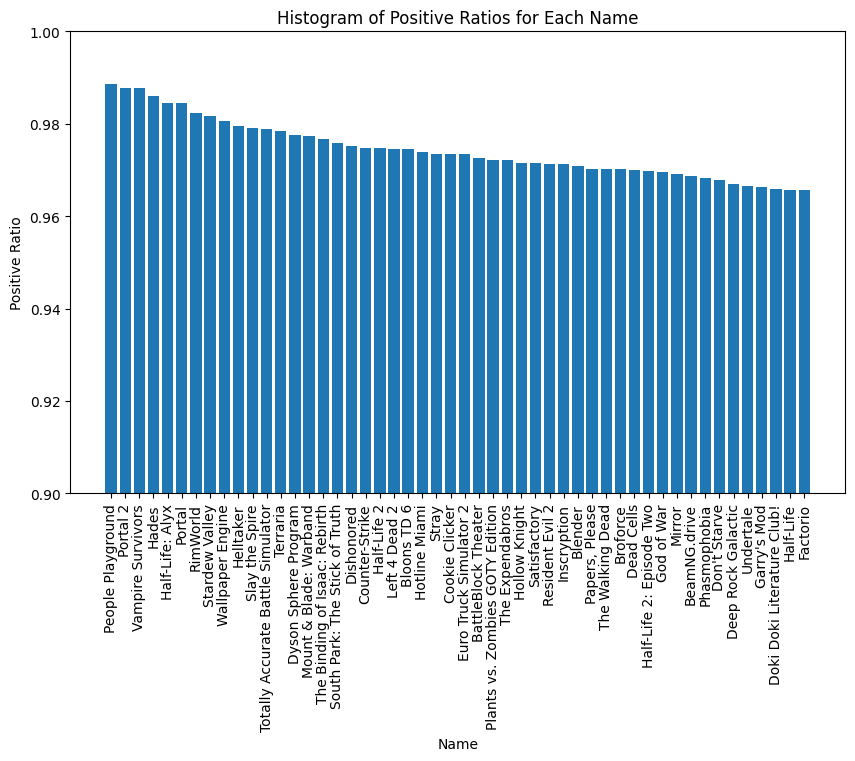

In [0]:
positive_ratio_df = most_owned.withColumn('positive_ratio', col('positive') / (col('positive') + col('negative')))

top_50_positive_ratio = positive_ratio_df.orderBy(col('positive_ratio').desc()).limit(50).toPandas()

plt.figure(figsize=(10, 6))
plt.bar(top_50_positive_ratio['name'], top_50_positive_ratio['positive_ratio'])
plt.xlabel('Name')
plt.ylabel('Positive Ratio')
plt.title('Histogram of Positive Ratios for Each Name')
plt.ylim(0.9, 1)
plt.xticks(rotation=90)
plt.show()

### On voit une nette différence entre les jeux ayant reçu le plus de notes positives et ceux ayant le meilleur ration notes positives/notes négatives. Ce ne sont pas les memes jeux. Notamment en terme de ratio on voit que ce sont des jeux Singleplayer qui dominent, là où les 4 premiers jeux ayant le plus reçu de notes positives sont des jeux online pvp

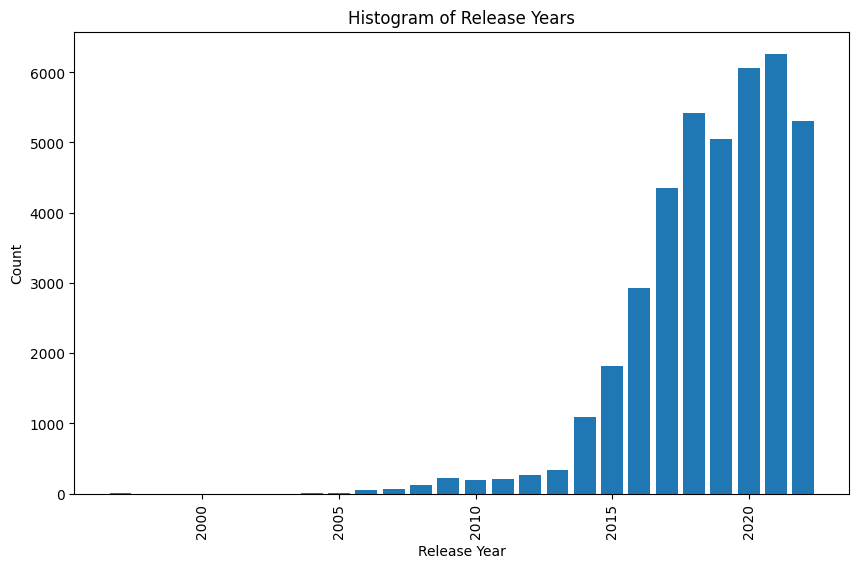

In [0]:
data_with_year = data.withColumn('release_year', year(to_date(col('release_date'), 'yyyy/MM/dd')))

release_year_counts = data_with_year.groupBy('release_year').count().orderBy('release_year').toPandas()

plt.figure(figsize=(10, 6))
plt.bar(release_year_counts['release_year'], release_year_counts['count'])
plt.xlabel('Release Year')
plt.ylabel('Count')
plt.title('Histogram of Release Years')
plt.xticks(rotation=90)
plt.show()

### Chute de mise en vente de jeux en 2019 (COVID), même si le tendance reste globalement à la hausse.

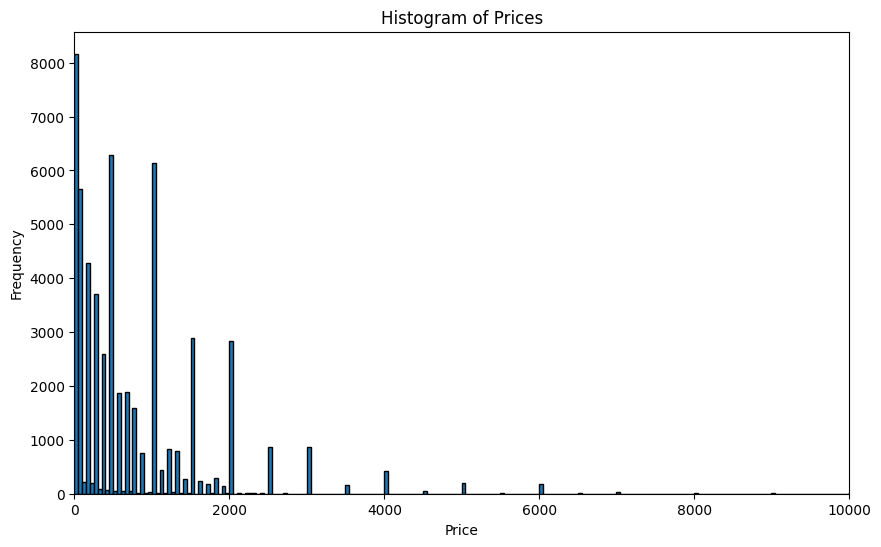

In [0]:

data = data.withColumn('price_numeric', expr("cast(price as double)"))

price_df = data.select('price_numeric').toPandas()

plt.figure(figsize=(10, 6))
plt.hist(price_df['price_numeric'].dropna(), bins=2000, edgecolor='k')
plt.xlim(0, 10000)
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Histogram of Prices')
plt.show()

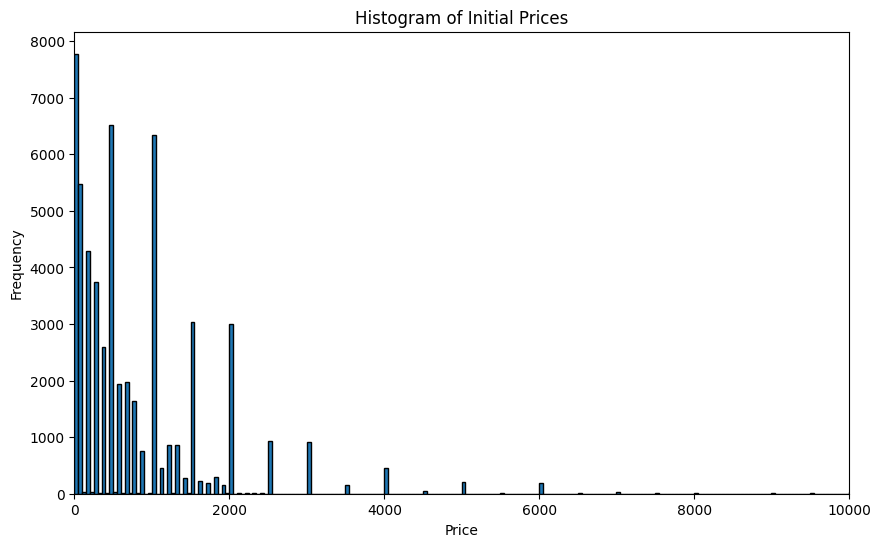

In [0]:
data = data.withColumn('initialprice_numeric', expr("cast(initialprice as double)"))

price_df = data.select('initialprice_numeric').toPandas()

plt.figure(figsize=(10, 6))
plt.hist(price_df['initialprice_numeric'].dropna(), bins=2000, edgecolor='k')
plt.xlim(0, 10000)
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Histogram of Initial Prices')
plt.show()

### Peu de différence entre les répartition de prix actuel et de prix inital : cela peu s'expliquer car on pas pu voir que la grande majorité des jeux sont des jeux récents qui n'ont que quelques années.

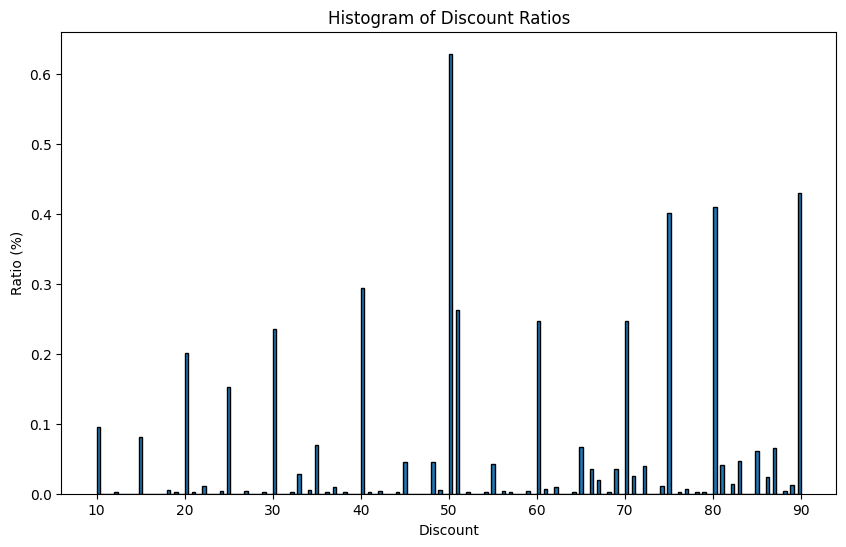

In [0]:
data = data.withColumn('discount_numeric', expr("cast(discount as double)"))

discount_counts = data.groupBy('discount_numeric').count()

total_count = data.count()

discount_ratio_df = discount_counts.withColumn('ratio', discount_counts['count']*100 / total_count)

discount_ratio_filtered = discount_ratio_df.filter(discount_ratio_df['discount_numeric'] != 0).toPandas()

plt.figure(figsize=(10, 6))
plt.hist(discount_ratio_filtered['discount_numeric'], weights=discount_ratio_filtered['ratio'], bins=200, edgecolor='k')
plt.xlabel('Discount')
plt.ylabel('Ratio (%)')
plt.title('Histogram of Discount Ratios')
plt.show()

In [0]:
non_zero_discount_count = data.filter(data['discount'] != '0').count()
total_count = data.count()
non_zero_discount_ratio = (non_zero_discount_count / total_count) * 100
non_zero_discount_ratio

4.52145807146705

### Seul 4.5% des jeux présente une remise, le plus souvent a -50%